# Generative learning for discrete MNIST data using randomly structured SPNs
This notebook shows how to build a randomly structured SPN and train it on binarized MNIST data.

### Setting up the imports and preparing the data

In [8]:
%matplotlib inline
import libspn as spn
import tensorflow as tf
import numpy as np
from libspn.examples.utils.dataiterator import DataIterator
import matplotlib.pyplot as plt

# Load
(train_x, train_y), (test_x, test_y) = tf.keras.datasets.mnist.load_data()

def binarize(x):
    return np.where(np.greater(x / 255., 0.25), 1.0, 0.0)

def flatten(x):
    return x.reshape(-1, np.prod(x.shape[1:]))

def preprocess(x, y):
    return binarize(flatten(x)).astype(int), np.expand_dims(y, axis=1)

# Preprocess
train_x, train_y = preprocess(train_x, train_y)
test_x, test_y = preprocess(test_x, test_y)

### Defining the hyperparameters

In [2]:
# Number of variable subsets that a product joins
num_subsets = 2
# Number of sums per scope
num_mixtures = 4
# Number of decompositions per product layer
num_decomps = 1
# Generate balanced subsets -> balanced tree
balanced = True
# Input distribution. Raw corresponds to first layer being product that 
# takes raw indicators
input_dist = spn.DenseSPNGenerator.InputDist.RAW
# Number of different values at leaf (binary here, so 2)
num_leaf_values = 2
# Initial value for path count accumulators
initial_accum_value = 0.1
# Inference type (can also be spn.InferenceType.MPE) where 
# sum nodes are turned into max nodes
inference_type = spn.InferenceType.MARGINAL

# Number of classes
num_classes = 10
batch_size = 32
num_epochs = 2


### Building the SPN

In [3]:
# Leaf nodes
leaf_indicators = spn.IVs(num_vals=num_leaf_values, num_vars=train_x.shape[1])

# Generates densely connected random SPNs
dense_generator = spn.DenseSPNGenerator(
    num_subsets=num_subsets, num_mixtures=num_mixtures, num_decomps=num_decomps, 
    balanced=balanced, input_dist=input_dist)

# Generate a dense SPN for each class
class_roots = [dense_generator.generate(leaf_indicators) for _ in range(num_classes)]

# Connect sub-SPNs to a root
root = spn.Sum(*class_roots, name="RootSum")

# Add an IVs node to the root as a latent class variable
class_indicators = root.generate_ivs()

# Generate the weights for the SPN rooted at `root`
spn.generate_weights(root)

### Defining the TensorFlow graph

In [4]:
# Op for initializing all weights
weight_init_op = spn.initialize_weights(root)
# Op for getting the log probability of the root
root_log_prob = root.get_log_value(inference_type=inference_type)

# Helper for constructing EM learning ops
em_learning = spn.EMLearning(
    initial_accum_value=initial_accum_value, root=root, value_inference_type=inference_type)
# Accumulate counts and update weights
online_em_update_op = em_learning.accumulate_and_update_weights()
# Op for initializing accumulators
init_accumulators = em_learning.reset_accumulators()

# MPE state generator
mpe_state_generator = spn.MPEState()
# Generate MPE state ops for leaf indicator and class indicator
leaf_indicator_mpe, class_indicator_mpe = mpe_state_generator.get_state(root, leaf_indicators, class_indicators)

### Display TF Graph
Only works with Chrome browser.

In [5]:
spn.display_tf_graph()

### Training the SPN

In [6]:
# Set up some convenient iterators
train_iterator = DataIterator([train_x, train_y], batch_size=batch_size)
test_iterator = DataIterator([test_x, test_y], batch_size=batch_size)

def fd(x, y):
    return {leaf_indicators: x, class_indicators: y}

with tf.Session() as sess:
    # Initialize things
    sess.run([weight_init_op, tf.global_variables_initializer(), init_accumulators])
    
    # Do one run for test likelihoods
    log_likelihoods = []
    for batch_x, batch_y in test_iterator.iter_epoch("Testing"):
        batch_llh = sess.run(root_log_prob, fd(batch_x, batch_y))
        log_likelihoods.extend(batch_llh)
        test_iterator.display_progress(LLH="{:.2f}".format(np.mean(batch_llh)))
    mean_test_llh = np.mean(log_likelihoods)
    
    print("Before training test LLH = {:.2f}".format(mean_test_llh))                              
    for epoch in range(num_epochs):
        
        # Train
        log_likelihoods = []
        for batch_x, batch_y in train_iterator.iter_epoch("Training"):
            batch_llh, _ = sess.run(
                [root_log_prob, online_em_update_op], fd(batch_x, batch_y))
            log_likelihoods.extend(batch_llh)
            train_iterator.display_progress(LLH="{:.2f}".format(np.mean(batch_llh)))
        mean_train_llh = np.mean(log_likelihoods)
        
        # Test
        log_likelihoods, matches = [], []
        for batch_x, batch_y in test_iterator.iter_epoch("Testing"):
            batch_llh, batch_class_mpe = sess.run([root_log_prob, class_indicator_mpe], fd(batch_x, -np.ones_like(batch_y, dtype=int)))
            log_likelihoods.extend(batch_llh)
            matches.extend(np.equal(batch_class_mpe, batch_y))
            test_iterator.display_progress(LLH="{:.2f}".format(np.mean(batch_llh)))
        mean_test_llh = np.mean(log_likelihoods)
        mean_test_acc = np.mean(matches)
        
        # Report
        print("Epoch {}, train LLH = {:.2f}, test LLH = {:.2f}, test accuracy = {:.2f}".format(
            epoch, mean_train_llh, mean_test_llh, mean_test_acc))
    
    # Compute MPE state of all digits
    per_class_mpe = sess.run(leaf_indicator_mpe, fd(
        -np.ones([num_classes, train_x.shape[1]], dtype=int), 
        np.expand_dims(np.arange(num_classes, dtype=int), 1)))
    

Training:   0%|          | 0/1875 [00:00<?, ?it/s]

Before training test LLH = -545.73


Training:   0%|          | 1/1875 [00:00<03:27,  9.03it/s, LLH=-168.92]

Epoch 0, train LLH = -178.90, test LLH = -172.84, test accuracy = 0.87


Testing: 100%|██████████| 313/313 [00:13<00:00, 23.81it/s, LLH=-166.90]


Epoch 1, train LLH = -176.56, test LLH = -172.36, test accuracy = 0.88


### Visualize MPE state per class

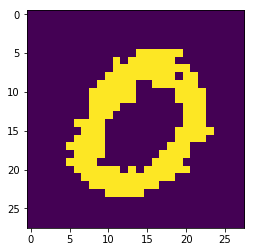

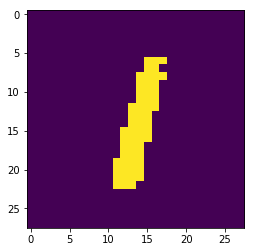

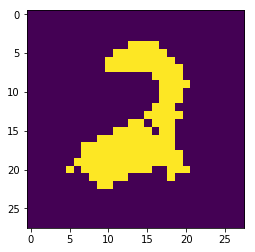

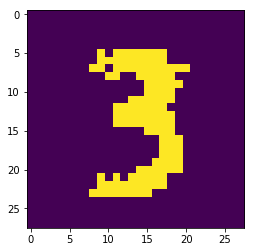

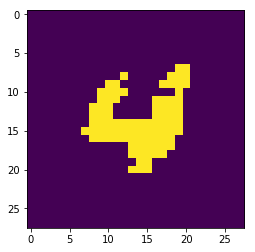

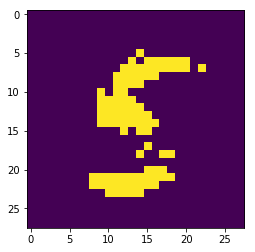

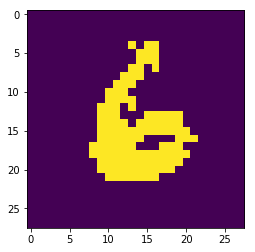

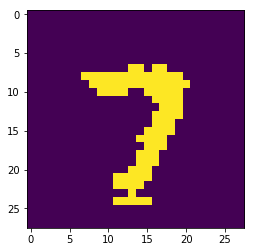

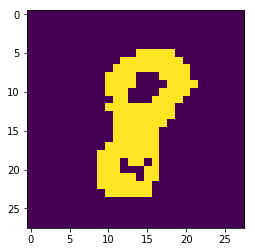

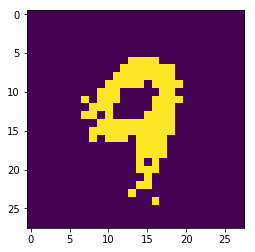

In [9]:
for sample in per_class_mpe:
    _, ax = plt.subplots()
    ax.imshow(sample.reshape(28, 28).astype(float))
    plt.show()